<a href="https://colab.research.google.com/github/rachanrv/Twitter-Mining-with-GCP/blob/master/8_TweetClassification_RV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# RNN Text: Tweet Classification
**University of Connecticut**

Full Name: BHOOSHI RACHAN VAMSI



# **LIONEL MESSI VS CHRISTIANO RONALDO**

Soccer was founded in 1888 and has a lot of fans all around the world.In [Wikipedia](https://en.wikipedia.org/wiki/Football),Soccer is defined as a family of team sports that involve, to varying degrees, kicking a ball to score a goal.The two renowned soccer players with a massive fanbase are Argentinian forward **Lionel Messi** and Portuguese forward **Christiano Ronaldo**. So,I want to perform a text analysis on these 2 players to know whose tweet it is.With this analysis, we can predict the player according to tweet.We can know the different catch phrases for the players.

# PART-I:Data Preparation

SHARABLE LINK FOR DIRECTORIES: https://drive.google.com/drive/folders/12MXjAUwVmCA2ocd4UE-R2RTQNWrgCZSI?usp=sharing

## Scraping the data from Twitter

In [ ]:
#mounting drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential
from keras.layers import Dense, Embedding, GRU, LSTM, SpatialDropout1D, Flatten, Bidirectional,  Dropout, Embedding, LSTM, Bidirectional
from sklearn.model_selection import train_test_split
from keras.utils.np_utils import to_categorical
from keras.callbacks import EarlyStopping,TensorBoard
from keras import layers
from keras.layers.convolutional import Conv1D
from keras.layers.convolutional import MaxPooling1D
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import datetime

In [ ]:
!pip install snscrape
import snscrape.modules.twitter as sntwitter
import csv

In [ ]:
# making a folder to store data
base_dir = '/content/drive/MyDrive/DEEP LEARNING/EXAM/Messi versus Ronaldo'

import tensorflow as tf

#Creating a new directory (a folder) in your Drive
tf.io.gfile.mkdir(base_dir)

#Combining the 2 strings
gates_dir = base_dir + '/Messi/'

#Creating the second directory
tf.io.gfile.mkdir(gates_dir)

In [ ]:
maxTweets = 2005  # 2005 tweets


for i,tweet in enumerate(sntwitter.TwitterSearchScraper('from:@TeamMessi + since:2015-12-02 until:2020-11-23-filter:links -filter:replies').get_items()):
  csvFile = open(gates_dir + str(i) + '.csv', 'a', newline='', encoding='utf8')
  csvWriter = csv.writer(csvFile)
  csvWriter.writerow(['id','date','tweet',])

  if i > maxTweets :
    break
  csvWriter.writerow([tweet.id, tweet.date, tweet.content])
csvFile.close()

In [ ]:
# making  a folder to store data
base_dir = '/content/drive/MyDrive/DEEP LEARNING/EXAM/Messi versus Ronaldo'

import tensorflow as tf

#Creating a new directory (a folder) in your Drive
tf.io.gfile.mkdir(base_dir)

#Combining the 2 strings
gates_dir = base_dir + '/Ronaldo/'

#Creating the second directory
tf.io.gfile.mkdir(gates_dir)

In [ ]:
maxTweets = 2005 # 2005 tweets
 
for i,tweet in enumerate(sntwitter.TwitterSearchScraper('from:@Cristiano + since:2015-12-02 until:2020-11-23-filter:links -filter:replies').get_items()):
  csvFile = open(gates_dir + str(i) + '.csv', 'a', newline='', encoding='utf8')
  csvWriter = csv.writer(csvFile)
  csvWriter.writerow(['id','date','tweet',])

  if i > maxTweets :
    break
  csvWriter.writerow([tweet.id, tweet.date, tweet.content])
csvFile.close()

##  Tokenize, pad the sequences and split data to training and validation.

In [ ]:
#Loading the data we just saved from our drive
import os

my_dir = base_dir

labels = []
texts = []
count = 0
for label_type in ['Messi/', 'Ronaldo/']:
    dir_name = os.path.join(my_dir, label_type)
    for fname in os.listdir(dir_name):
        if fname[-4:] == '.csv':
            count = count + 1
            print(count)
            f = open(os.path.join(dir_name, fname))
            texts.append(f.read())
            f.close()
            if label_type == 'Messi/':
                labels.append(0) #0 means messi
            else:
                labels.append(1) #1 means ronaldo

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


In [ ]:
# Tokenize, pad and prepare training and validation data
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import numpy as np

maxlen = 50 # or 50
validation_samples = 500 # We will be validating on 500 samples
max_words = 500  # We will only consider the top 500 words in the dataset

tokenizer = Tokenizer(num_words=max_words)

# fit_on_texts means it learns the indices of the words
tokenizer.fit_on_texts(texts)

# the sequences are comprised of those indices
sequences = tokenizer.texts_to_sequences(texts)

word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

# in case of low word counts, we need to pad sequences
# so that they are uniform length
data = pad_sequences(sequences, maxlen=maxlen)

# our labels, which were previously stored as a list [],
# are now converted to a numpy array for modeling
labels = np.asarray(labels)
print('Shape of data tensor:', data.shape)
print('Shape of label tensor:', labels.shape)

Found 7672 unique tokens.
Shape of data tensor: (1639, 50)
Shape of label tensor: (1639,)


In [ ]:
indices = np.arange(data.shape[0])
np.random.shuffle(indices)
data = data[indices]
labels = labels[indices]

training_samples = 1000  # We will be training on 1000 samples

x_train = data[:training_samples] # from 0 to training samples that is 1000
y_train = labels[:training_samples]
x_val = data[training_samples: training_samples + validation_samples]
y_val = labels[training_samples: training_samples + validation_samples]

In [ ]:
print(x_train.shape, y_train.shape)
print(x_val.shape, y_val.shape)

(1000, 50) (1000,)
(500, 50) (500,)


# PART-II:Modeling

# Embedding,LSTM and Dense Layer 

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, Flatten, Dense, LSTM

model = Sequential()
model.add(Embedding(max_words, 8, input_length=maxlen))
model.add(LSTM(64, dropout=0.1, recurrent_dropout=0.1))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 50, 8)             4000      
_________________________________________________________________
lstm (LSTM)                  (None, 64)                18688     
_________________________________________________________________
dense (Dense)                (None, 32)                2080      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 33        
Total params: 24,801
Trainable params: 24,801
Non-trainable params: 0
_________________________________________________________________


In [ ]:
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['acc'])


# early stopping
es = EarlyStopping(monitor='val_acc', 
                   mode='max', 
                   patience=20, 
                   verbose=1,
                   restore_best_weights=True)

history = model.fit(x_train, y_train,
                    epochs=25,
                    batch_size=100,
                    validation_data=(x_val, y_val),verbose=1,
                    callbacks=[es],
                    shuffle=True)

Epoch 1/25
10/10 [==============================] - 1s 106ms/step - loss: 0.6765 - acc: 0.6970 - val_loss: 0.6406 - val_acc: 0.7340
Epoch 2/25
10/10 [==============================] - 1s 71ms/step - loss: 0.6058 - acc: 0.7250 - val_loss: 0.5657 - val_acc: 0.7340
Epoch 3/25
10/10 [==============================] - 1s 69ms/step - loss: 0.5906 - acc: 0.7250 - val_loss: 0.5803 - val_acc: 0.7340
Epoch 4/25
10/10 [==============================] - 1s 70ms/step - loss: 0.5590 - acc: 0.7250 - val_loss: 0.5225 - val_acc: 0.7340
Epoch 5/25
10/10 [==============================] - 1s 69ms/step - loss: 0.5011 - acc: 0.7250 - val_loss: 0.4544 - val_acc: 0.7360
Epoch 6/25
10/10 [==============================] - 1s 72ms/step - loss: 0.3849 - acc: 0.7970 - val_loss: 0.3127 - val_acc: 0.9000
Epoch 7/25
10/10 [==============================] - 1s 70ms/step - loss: 0.2530 - acc: 0.9310 - val_loss: 0.2415 - val_acc: 0.9300
Epoch 8/25
10/10 [==============================] - 1s 69ms/step - loss: 0.1848 - 

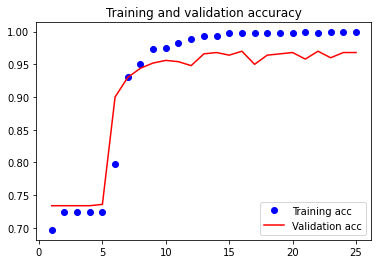

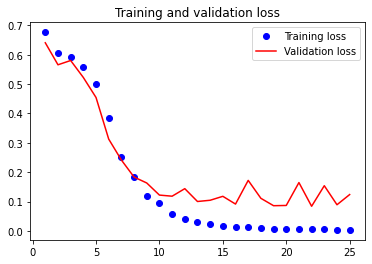

In [ ]:
import matplotlib.pyplot as plt

acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

## **Classification Report**

In [ ]:
# put it all together for other models
# make a prediction
pred = model.predict(x_val)# the pred
# print(pred) 

pred = np.round(pred,0)
# print(pred) 

# classifiaction report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
print(classification_report(y_val, pred))

              precision    recall  f1-score   support

           0       0.98      0.89      0.94       133
           1       0.96      0.99      0.98       367

    accuracy                           0.97       500
   macro avg       0.97      0.94      0.96       500
weighted avg       0.97      0.97      0.97       500



## **Confusion Matrix**

Text(0.5, 1.0, 'CONFUSION MATRIX')

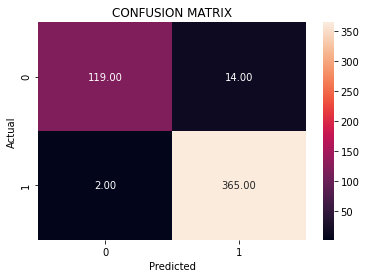

In [ ]:
cm1=confusion_matrix(y_val, pred) #confusion matrix
conf1=sns.heatmap(data=cm1, annot=True,fmt=".2f").set_title('CONFUSION MATRIX')
plt.ylabel("Actual")
plt.xlabel("Predicted")
conf1

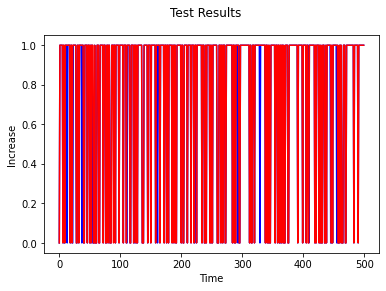

In [ ]:
# show timeseries plot on the train and validation data
plt.plot(np.arange(x_val.shape[0]), y_val, color='blue') # actual data
plt.plot(np.arange(x_val.shape[0]), pred, color='red') # predicted data
plt.suptitle('Test Results')
plt.xlabel('Time')
plt.ylabel('Increase')
plt.show()

In [ ]:
# show timeseries plot on the train and validation data
val=np.arange(x_val.shape[0])
pred1=pred.T[0]
fig = go.Figure()
fig.add_trace(go.Scatter(x=val,y=y_val,
                    mode='lines',
                    name='Actual'))
fig.add_trace(go.Scatter(x=val,y=pred1,
                    mode='lines+markers',
                    name='Prediction'))
# Edit the layout
fig.update_layout(title='Test Results',
                   xaxis_title='Time',
                   yaxis_title='Increase')
fig.show()

# Embedding,GRU and Dense Layer

In [ ]:
from tensorflow.keras.layers import GRU

model = Sequential()
model.add(Embedding(max_words, 50, input_length=maxlen))
model.add(GRU(64, dropout=0.1, recurrent_dropout=0.1))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.summary()
model.compile(optimizer='rmsprop',
              loss='binary_crossentropy',
              metrics=['acc'])

# early stopping
es = EarlyStopping(monitor='val_acc', 
                   mode='max', 
                   patience=20, 
                   verbose=1,
                   restore_best_weights=True)

history = model.fit(x_train, y_train,
                    epochs=50,
                    batch_size=100,
                    validation_data=(x_val, y_val),verbose=1,
                    callbacks=[es],
                    shuffle=True)


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, 50, 50)            25000     
_________________________________________________________________
gru (GRU)                    (None, 64)                22272     
_________________________________________________________________
dense_2 (Dense)              (None, 32)                2080      
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 33        
Total params: 49,385
Trainable params: 49,385
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 1s 112ms/step - loss: 0.6357 - acc: 0.6810 - val_loss: 0.5463 - val_acc: 0.7340
Epoch 2/50
10/10 [==============================] - 1s 74ms/step - loss: 0.5318 - acc: 0.7400 - val_loss: 0.4004 - v

## **Classification Report**

In [ ]:
# put it all together for other models
# make a prediction
pred = model.predict(x_val)# the pred
# print(pred) 

pred = np.round(pred,0)
# print(pred) 

# classifiaction report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
print(classification_report(y_val, pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       133
           1       0.99      0.99      0.99       367

    accuracy                           0.99       500
   macro avg       0.99      0.99      0.99       500
weighted avg       0.99      0.99      0.99       500



## **Confusion Matrix**

Text(0.5, 1.0, 'CONFUSION MATRIX')

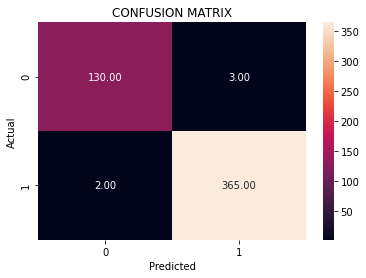

In [ ]:
cm1=confusion_matrix(y_val, pred) #confusion matrix
conf1=sns.heatmap(data=cm1, annot=True,fmt=".2f").set_title('CONFUSION MATRIX')
plt.ylabel("Actual")
plt.xlabel("Predicted")
conf1

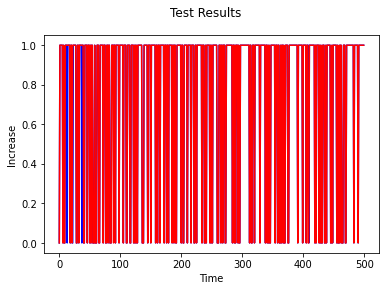

In [ ]:
# show timeseries plot on the train and validation data
plt.plot(np.arange(x_val.shape[0]), y_val, color='blue') # actual data
plt.plot(np.arange(x_val.shape[0]), pred, color='red') # predicted data
plt.suptitle('Test Results')
plt.xlabel('Time')
plt.ylabel('Increase')
plt.show()

In [ ]:
# show timeseries plot on the train and validation data
val=np.arange(x_val.shape[0])
pred1=pred.T[0]
fig = go.Figure()
fig.add_trace(go.Scatter(x=val,y=y_val,
                    mode='lines',
                    name='Actual'))
fig.add_trace(go.Scatter(x=val,y=pred1,
                    mode='lines+markers',
                    name='Prediction'))
# Edit the layout
fig.update_layout(title='Test Results',
                   xaxis_title='Time',
                   yaxis_title='Increase')
fig.show()

# Embedding,Conv1D,Pooling,Bidirectional,GRU and Dense Layer

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
from tensorflow.keras.layers import Flatten

model = Sequential()
model.add(Embedding(max_words, 8, input_length=maxlen))
model.add(Conv1D(filters=64, kernel_size=2)) 
model.add(MaxPooling1D(2))
model.add(Bidirectional(LSTM(32, activation='relu', return_sequences=True)))
model.add(GRU(32, activation='relu', return_sequences=True))
model.add(Bidirectional(LSTM(16, activation='relu')))
model.add(Dropout(0.1)) # pick a number 0.1
model.add(Dense(16, activation='relu'))
model.add(Dense(1,activation='sigmoid'))
model.summary()
model.compile(optimizer='rmsprop',
              loss='binary_crossentropy',
              metrics=['acc'])

#tensorboard
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

history = model.fit(x_train, y_train,
          epochs=50, 
          batch_size=100, 
          validation_data=(x_val, y_val), 
          verbose=1,
          callbacks=[tensorboard_callback],
          shuffle=True)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (None, 50, 8)             4000      
_________________________________________________________________
conv1d (Conv1D)              (None, 49, 64)            1088      
_________________________________________________________________
max_pooling1d (MaxPooling1D) (None, 24, 64)            0         
_________________________________________________________________
bidirectional (Bidirectional (None, 24, 64)            24832     
_________________________________________________________________
gru_1 (GRU)                  (None, 24, 32)            9408      
_________________________________________________________________
bidirectional_1 (Bidirection (None, 32)                6272      
_________________________________________________________________
dropout (Dropout)            (None, 32)               

In [ ]:
!kill 4846  #delete the previous port

In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

## **Classification Report**

In [ ]:
# put it all together for other models
# make a prediction
pred = model.predict(x_val)# the pred

#print(pred) 

pred = np.round(pred,0)
# print(pred) 

# classifiaction report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
print(classification_report(y_val,pred))

              precision    recall  f1-score   support

           0       0.97      0.98      0.98       133
           1       0.99      0.99      0.99       367

    accuracy                           0.99       500
   macro avg       0.98      0.99      0.98       500
weighted avg       0.99      0.99      0.99       500



## **Confusion Matrix**

Text(0.5, 1.0, 'CONFUSION MATRIX')

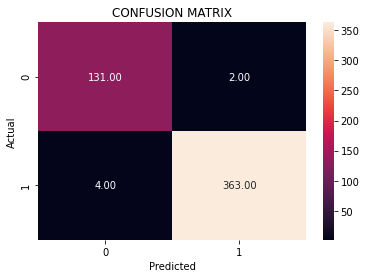

In [ ]:
cm1=confusion_matrix(y_val, pred) #confusion matrix
conf1=sns.heatmap(data=cm1, annot=True,fmt=".2f").set_title('CONFUSION MATRIX')
plt.ylabel("Actual")
plt.xlabel("Predicted")
conf1

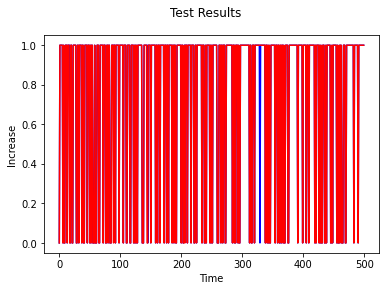

In [ ]:
# show timeseries plot on the train and validation data
plt.plot(np.arange(x_val.shape[0]), y_val, color='blue') # actual data
plt.plot(np.arange(x_val.shape[0]), pred, color='red') # predicted data
plt.suptitle('Test Results')
plt.xlabel('Time')
plt.ylabel('Increase')
plt.show()

In [ ]:
# show timeseries plot on the train and validation data
val=np.arange(x_val.shape[0])
pred1=pred.T[0]
fig = go.Figure()
fig.add_trace(go.Scatter(x=val,y=y_val,
                    mode='lines',
                    name='Actual'))
fig.add_trace(go.Scatter(x=val,y=pred1,
                    mode='lines+markers',
                    name='Prediction'))
# Edit the layout
fig.update_layout(title='Test Results',
                   xaxis_title='Time',
                   yaxis_title='Increase')
fig.show()

# PART-III:Analysis

# Find top 50 words for each person

In [ ]:
labels_ = []
texts_ = []
count = 0
for label_type in ['Messi/', 'Ronaldo/']:
    dir_name = os.path.join(my_dir, label_type)
    for fname in os.listdir(dir_name):
        if fname[-4:] == '.csv':
            count = count + 1
            f = open(os.path.join(dir_name, fname))
            texts_.append(f.read())
            f.close()
            if label_type == 'Messi/':
                labels_.append('Messi')
            else:
                labels_.append('Ronaldo')

In [ ]:
import pandas as pd
dic={'Label':labels_,'Text':texts_}
df=pd.DataFrame(dic)
df_messi=df[df.Label=='Messi']
df_ronaldo=df[df.Label=='Ronaldo']

## Use lower characters

In [ ]:
df_messi.Text  = df_messi.Text.str.lower()
df_ronaldo.Text = df_ronaldo.Text.str.lower()

## Strip Characters

In [ ]:
df_messi.Text = df_messi.Text.str.replace('[^A-z ]','').str.replace(' +',' ').str.strip()
df_ronaldo.Text= df_ronaldo.Text.str.replace('[^A-z ]','').str.replace(' +',' ').str.strip()

## Removed stop words

In [ ]:
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

import matplotlib.pyplot as plt
% matplotlib inline

In [ ]:
import nltk
from nltk.corpus import stopwords


nltk.download('stopwords')
stop = stopwords.words('english')
stopwords = set(STOPWORDS)
stopwords.update(["https","iddatetweet'","'","co"])
stopwords.update(stop)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
df_messi.Text = df_messi.Text.apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)])) 
df_ronaldo.Text = df_ronaldo.Text.apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)])) 

In [ ]:
a=pd.Series(' '.join(df_messi.Text).split()).value_counts()[:50]
b=pd.Series(' '.join(df_ronaldo.Text).split()).value_counts()[:50]

In [ ]:
a_=pd.DataFrame(a,columns=['Messi'])
b_=pd.DataFrame(b,columns=['Ronaldo'])

In [ ]:
c=pd.concat([a_,b_],axis=1,join='outer',ignore_index=False)
c.info()

<class 'pandas.core.frame.DataFrame'>
Index: 88 entries, iddatetweet to madeira
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Messi    50 non-null     float64
 1   Ronaldo  50 non-null     float64
dtypes: float64(2)
memory usage: 2.1+ KB


Word Cloud reference:  https://www.datacamp.com/community/tutorials/wordcloud-python

In [ ]:
from google.colab.patches import cv2_imshow

##Messi

###Image

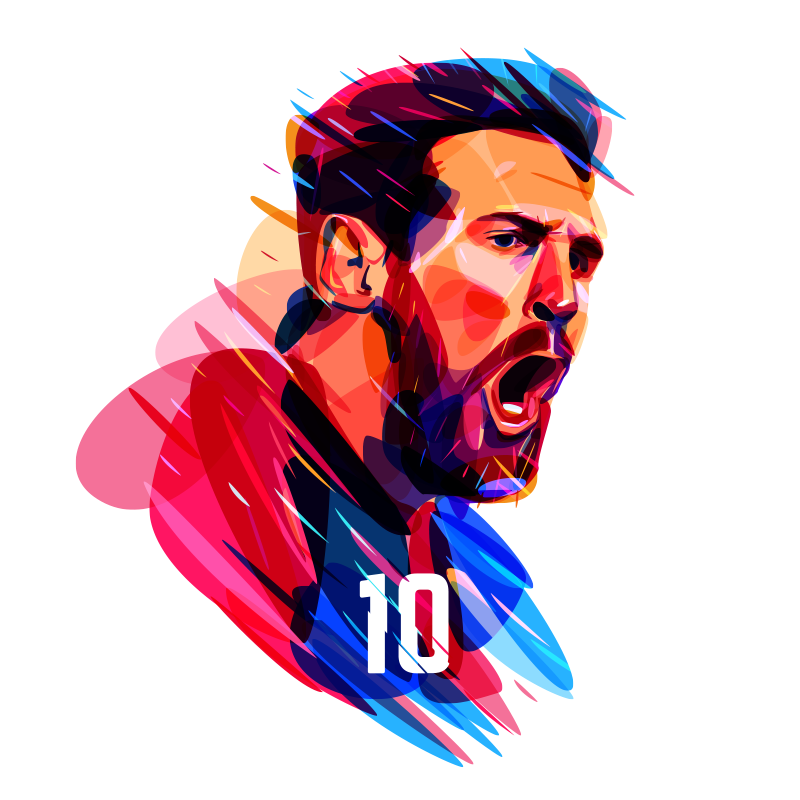

In [ ]:
import cv2
img = cv2.imread('/content/drive/MyDrive/DEEP LEARNING/EXAM/Messi versus Ronaldo/leo.png', cv2.IMREAD_UNCHANGED)
cv2_imshow(img)

###Word Cloud

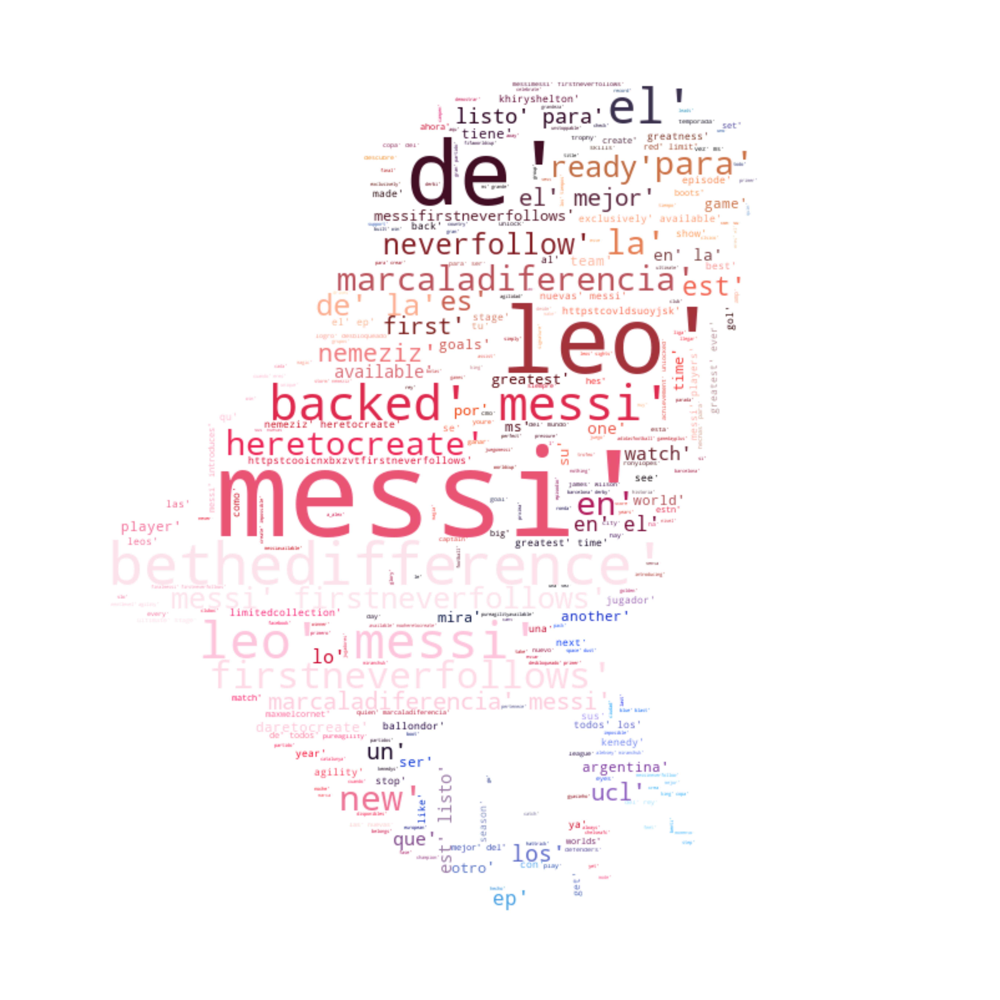

In [ ]:
mask = np.array(Image.open("/content/drive/MyDrive/DEEP LEARNING/EXAM/Messi versus Ronaldo/leo.png")) #change the path
mes=str(' '.join(df_messi.Text).split())
wordcloud_mes = WordCloud(stopwords=stopwords,background_color="white", mode="RGBA", max_words=1000, mask=mask).generate(mes)

# create coloring from image
image_colors = ImageColorGenerator(mask)
plt.figure(figsize=[100,100])
plt.imshow(wordcloud_mes.recolor(color_func=image_colors), interpolation="bilinear")
plt.axis("off")

# store to file
#plt.savefig("img/us_wine.png", format="png")
plt.show()

### Top 50 words

In [ ]:
a_

,Messi
iddatetweet,453
messi,302
leo,124
de,96
el,94
firstneverfollows,77
la,70
bethedifference,67
para,65
en,58


## Ronaldo

###Image

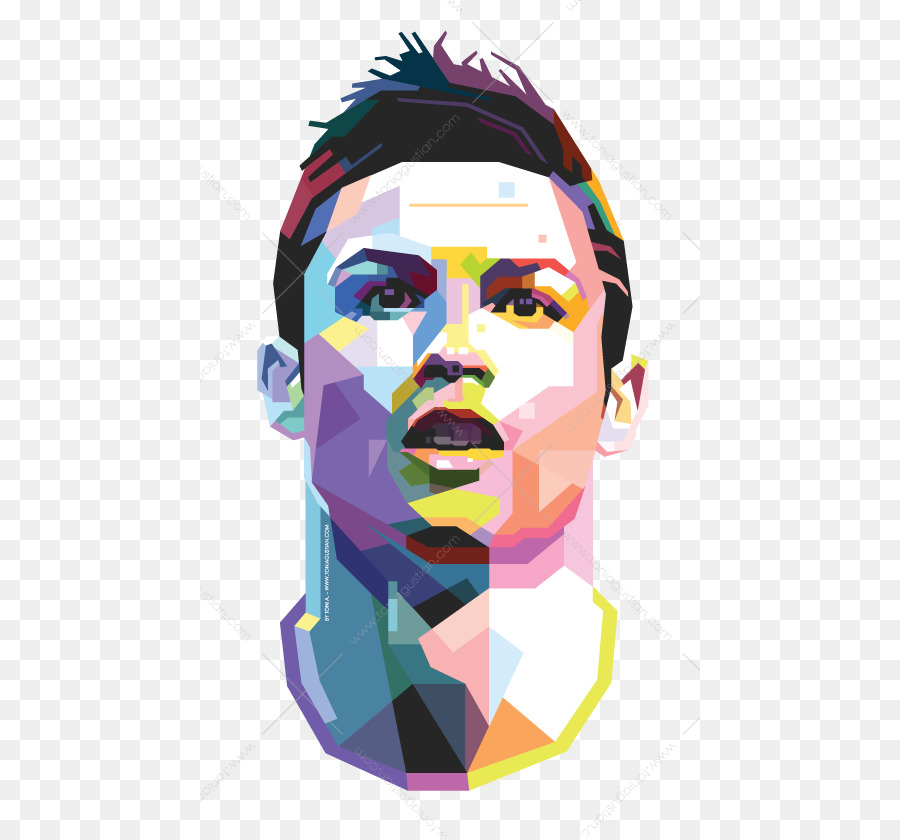

In [ ]:
import cv2
img = cv2.imread('/content/drive/MyDrive/DEEP LEARNING/EXAM/Messi versus Ronaldo/Chris.png', cv2.IMREAD_UNCHANGED)
cv2_imshow(img)

### Word Cloud

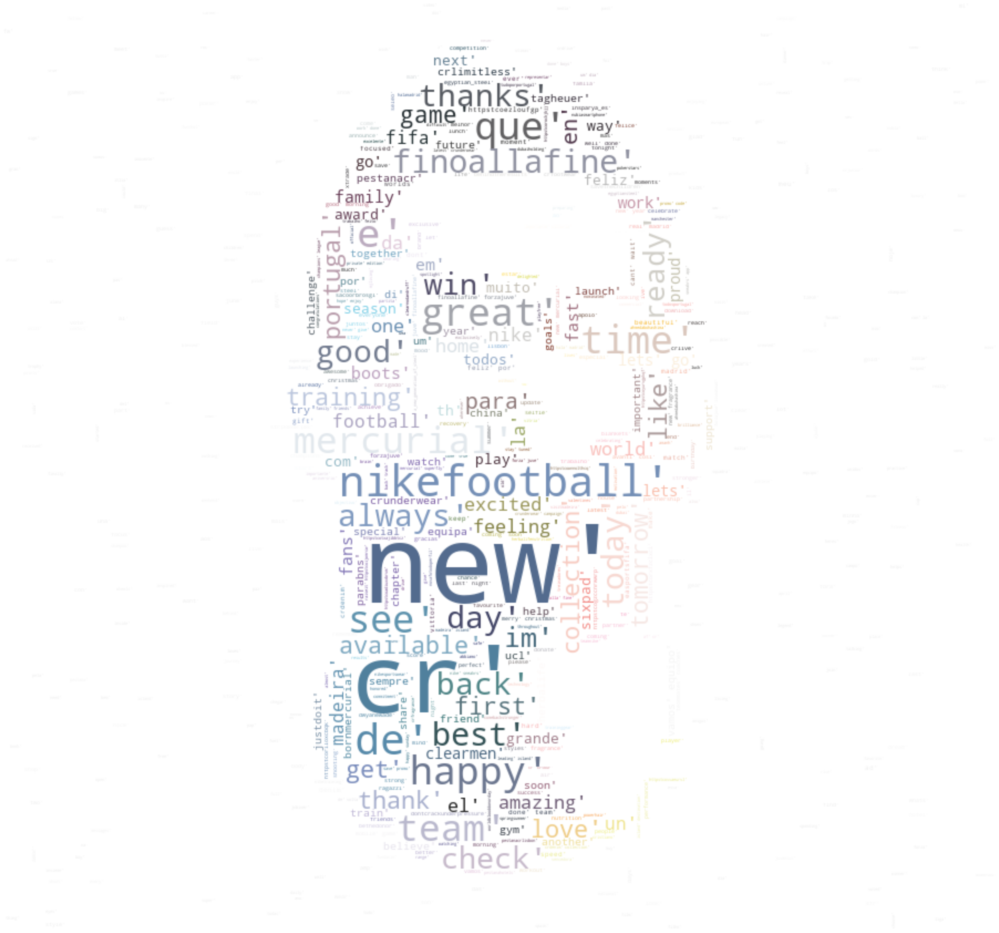

In [ ]:
mask = np.array(Image.open("/content/drive/MyDrive/DEEP LEARNING/EXAM/Messi versus Ronaldo/Chris.png")) #Change the path
ron=str(' '.join(df_ronaldo.Text).split())
wordcloud_ron = WordCloud(stopwords=stopwords,background_color="white", mode="RGBA", max_words=1000, mask=mask).generate(ron)

# create coloring from image
image_colors = ImageColorGenerator(mask)
plt.figure(figsize=[100,100])
plt.imshow(wordcloud_ron.recolor(color_func=image_colors), interpolation="bilinear")
plt.axis("off")

plt.show()

### Top 50 words

In [ ]:
# Ronaldo common words
b_

,Ronaldo
iddatetweet,1186
new,104
cr,69
nikefootball,53
de,53
team,50
mercurial,48
finoallafine,47
happy,46
e,43


# Improve accuracy

1. According to the analysis,accuracy of Embedding,LSTM and Dense Layer was 97%,Embedding,GRU and Dense Layer was 99% and Embedding,Conv1D,Pooling,Bidirectional,GRU and Dense Layer was 99%.

2. I improved each model by refining layers according to previous layers ,For example,as we see including GRU and a dense layer has increased our accuracy in the second model.

3. I also used Tensorboard to observe the bias and kernal changes to see the significant layer and refined the model.(FROM DISTRIBUTION GRAPHS).
I could remove some bidirectional LSTM layers which were redundant and didn't improve the model.

4. I also used the classification report and confusion matrix to measure the accuracy metrics and improve the accuracy.

5. Early stopping was also used in first and second models to get the predictions faster.

6. To improve the performance of the models, I would gather more MESSI tweets as we see both the observations less.

7. We can also decode emojis in utf-8 format like \x09x0878 in the tweet that we gathered to an emotion like feeling happy,feeling sad etc or use stemming.

8. I would also improve text handling by only scraping english tweets as we see many are in other language because of diversified fan base.

9. We can also add or decrease dropout to the increase accuracy.

10. More Layers like LSTM ,Simple RNN and GRU can be added to test how the accuracy changes and the change can be implemented.



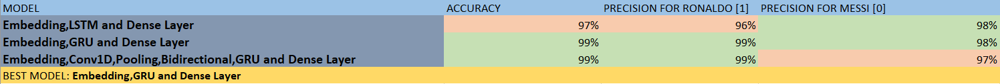